In [ ]:
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [14]:
data = pd.read_csv('train.csv')
data.head()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied
0,748.0,2.75,1.0,75.00,24,6.300,105.300,0
1,1187.0,3.43,1.0,105.00,24,13.200,142.200,0
2,730.0,3.12,1.0,71.25,0,26.625,97.875,1
3,671.0,5.63,3.0,90.00,0,9.750,99.750,0
4,329.0,2.09,1.0,45.00,12,13.200,70.200,0


In [15]:
df = data.copy()
df.head()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied
0,748.0,2.75,1.0,75.00,24,6.300,105.300,0
1,1187.0,3.43,1.0,105.00,24,13.200,142.200,0
2,730.0,3.12,1.0,71.25,0,26.625,97.875,1
3,671.0,5.63,3.0,90.00,0,9.750,99.750,0
4,329.0,2.09,1.0,45.00,12,13.200,70.200,0


In [16]:
len(df)

209673

In [17]:
df.isna().sum()

trip_duration         0
distance_traveled     0
num_of_passengers     0
fare                  0
tip                   0
miscellaneous_fees    0
total_fare            0
surge_applied         0
dtype: int64

In [18]:
df.duplicated().sum()

4325

In [19]:
df = df.drop_duplicates()
df.head()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied
0,748.0,2.75,1.0,75.00,24,6.300,105.300,0
1,1187.0,3.43,1.0,105.00,24,13.200,142.200,0
2,730.0,3.12,1.0,71.25,0,26.625,97.875,1
3,671.0,5.63,3.0,90.00,0,9.750,99.750,0
4,329.0,2.09,1.0,45.00,12,13.200,70.200,0


In [52]:
df['num_of_passengers']==0.value.count()

SyntaxError: invalid decimal literal (917204047.py, line 1)

In [20]:
len(df)

205348

In [21]:
df.duplicated().sum()

0

## Feature Engineering

In [22]:
df['additional_charge'] = df.tip + df.miscellaneous_fees
df.head()

,trip_duration,distance_traveled,num_of_passengers,fare,tip,miscellaneous_fees,total_fare,surge_applied,additional_charge
0,748.0,2.75,1.0,75.00,24,6.300,105.300,0,30.300
1,1187.0,3.43,1.0,105.00,24,13.200,142.200,0,37.200
2,730.0,3.12,1.0,71.25,0,26.625,97.875,1,26.625
3,671.0,5.63,3.0,90.00,0,9.750,99.750,0,9.750
4,329.0,2.09,1.0,45.00,12,13.200,70.200,0,25.200


#### Kolom yang inign di pakai

In [23]:
df_fix = df[['distance_traveled', 'total_fare', 'additional_charge']]
df_fix.head()

,distance_traveled,total_fare,additional_charge
0,2.75,105.300,30.300
1,3.43,142.200,37.200
2,3.12,97.875,26.625
3,5.63,99.750,9.750
4,2.09,70.200,25.200


In [27]:
import plotly.express as px

# Create a DataFrame containing the selected attributes
attributes = ['distance_traveled', 'total_fare', 'additional_charge']
data = df_fix[attributes]

# Create a box plot with Plotly
fig = px.box(data, y=attributes, labels={'variable': 'Attributes', 'value': 'Range'},
             title="Outliers Variable Distribution")
fig.update_layout(
    xaxis=dict(title="Attributes"),
    yaxis=dict(title="Range"),
    showlegend=False,
    boxmode='group',  # Display box plots side by side
    width=800, height=600
)
fig.show()

In [28]:
# Removing (statistical) outliers for Amount
Q1 = df_fix.distance_traveled.quantile(0.25)
Q3 = df_fix.distance_traveled.quantile(0.75)
IQR = Q3 - Q1
df_fix = df_fix[(df_fix.distance_traveled >= Q1 - 1.5*IQR) & (df_fix.distance_traveled <= Q3 + 1.5*IQR)]

# Removing (statistical) outliers for Recency
Q1 = df_fix.total_fare.quantile(0.25)
Q3 = df_fix.total_fare.quantile(0.75)
IQR = Q3 - Q1
df_fix = df_fix[(df_fix.total_fare >= Q1 - 1.5*IQR) & (df_fix.total_fare <= Q3 + 1.5*IQR)]

# Removing (statistical) outliers for Frequency
Q1 = df_fix.additional_charge.quantile(0.25)
Q3 = df_fix.additional_charge.quantile(0.75)
IQR = Q3 - Q1
df_fix = df_fix[(df_fix.additional_charge >= Q1 - 1.5*IQR) & (df_fix.additional_charge <= Q3 + 1.5*IQR)]

In [42]:
df_fix.columns

Index(['distance_traveled', 'total_fare', 'additional_charge'], dtype='object')

In [44]:
# Memilih kolom-kolom yang akan di-transformasi
df_sqrt = np.sqrt(df_fix[['distance_traveled', 'total_fare', 'additional_charge']])
df_sqrt.head()

,distance_traveled,total_fare,additional_charge
0,1.658312,10.261579,5.504544
1,1.852026,11.924764,6.099180
2,1.766352,9.893179,5.159942
3,2.372762,9.987492,3.122499
4,1.445683,8.378544,5.019960


In [45]:
len(df_sqrt)

181512

In [46]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

data = df_sqrt[['distance_traveled', 'total_fare', 'additional_charge']]

scaler = MinMaxScaler()

scaled_data = scaler.fit_transform(data)

scaled_data

array([[0.46592769, 0.6632116 , 0.65384496],
       [0.52542866, 0.7707042 , 0.72447755],
       [0.49911314, 0.63940174, 0.61291221],
       ...,
       [0.30542734, 0.6310174 , 0.81064348],
       [0.4723698 , 0.5397716 , 0.29095719],
       [0.40799168, 0.5397716 , 0.43643578]])

In [47]:
df_scaled = pd.DataFrame(scaled_data)
df_scaled.columns = ['distance_traveled', 'total_fare', 'additional_charge']
df_scaled.head()

,distance_traveled,total_fare,additional_charge
0,0.465928,0.663212,0.653845
1,0.525429,0.770704,0.724478
2,0.499113,0.639402,0.612912
3,0.685378,0.645497,0.370899
4,0.400617,0.541510,0.596285


In [48]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3, random_state=42, n_init='auto')

kmeans.fit_transform(df_scaled)

array([[0.03400871, 0.32415329, 0.3211714 ],
       [0.16793974, 0.44679894, 0.21764278],
       [0.07138226, 0.28642308, 0.3184489 ],
       ...,
       [0.20562622, 0.47297103, 0.48190675],
       [0.38393958, 0.09100573, 0.57597018],
       [0.24815185, 0.07791092, 0.51708952]])

<Axes: xlabel='total_fare', ylabel='additional_charge'>

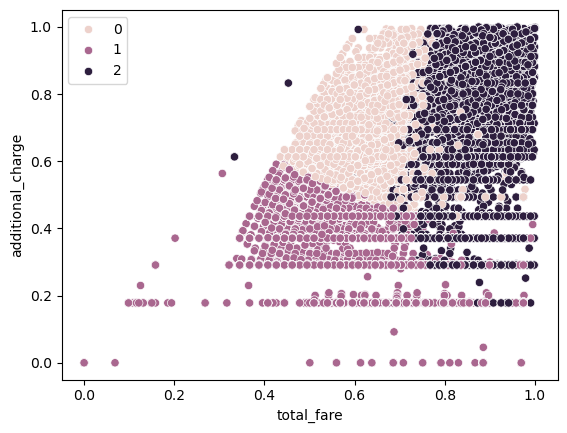

In [49]:
sns.scatterplot(data = df_scaled, x = 'total_fare', y = 'additional_charge', hue = kmeans.labels_)

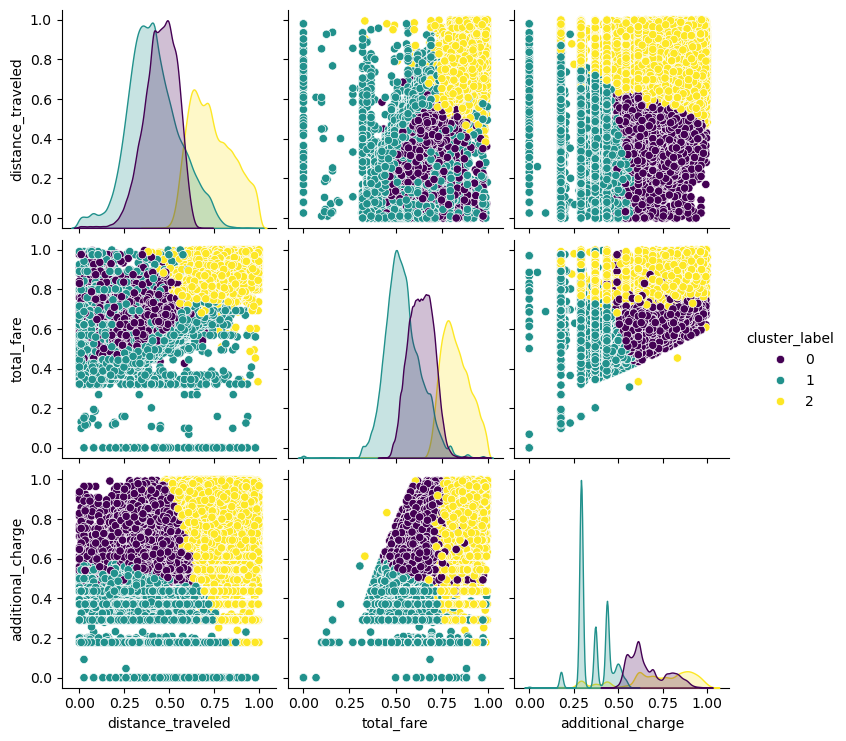

In [50]:
# Fit model dan tambahkan label cluster ke DataFrame
df_scaled['cluster_label'] = kmeans.fit_predict(df_scaled)  # Menggunakan fit_predict untuk mendapatkan label cluster

# Visualisasi dengan pairplot
sns.pairplot(df_scaled, hue='cluster_label', palette='viridis')
plt.show()

In [ ]:
from sklearn.metrics import silhouette_score

K = range(1, 11)
silhouette_scores = []
models = {}  

# Melakukan clustering untuk setiap nilai k dan menghitung silhouette score
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init='auto')
    df_scaled[f'cluster_label_{k}'] = kmeans.fit_predict(df_scaled)  # Menambahkan label cluster ke DataFrame
    
    # Hitung silhouette score jika k > 1
    if k > 1:
        score = silhouette_score(df_scaled, df_scaled[f'cluster_label_{k}'], metric='euclidean')
        silhouette_scores.append(score)
    else:
        silhouette_scores.append(float('nan'))  # Mengisi NaN untuk k=1

In [53]:
# Mengambil nilai terbesar, mengabaikan NaN
max_value = max(filter(lambda x: not pd.isna(x), silhouette_scores))

# Cetak nilai terbesar dalam persentase dengan dua angka di belakang koma
print(f"Nilai terbesar adalah: {max_value * 100:.2f}%")

Nilai terbesar adalah: 97.16%


In [ ]:
# Plot silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(K, silhouette_scores, marker='o', linestyle='--')
plt.title('Silhouette Scores for Different Values of k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.xticks(K)
plt.grid(True)
plt.show()